In [1]:
import os
import zarr
import random
import json
import warnings
import numpy as np
import pandas as pd
import torch.nn as nn
from pathlib import Path
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, Dataset
from collections import defaultdict
import sys
import torch
import torchvision.transforms.functional as F
import random

warnings.filterwarnings("ignore")
sys.path.append("./src/")

from src.config import CFG
from src.dataloader import (
    read_zarr,
    read_info_json,
    scale_coordinates,
    create_dataset,
    create_segmentation_map,
    EziiDataset,
    drop_padding,
)
from src.network import UNet_2D, aug
from src.utils import save_images
from src.metric import score, create_cls_pos, create_cls_pos_sikii, create_df
from metric import visualize_epoch_results

In [2]:
train_dataset = EziiDataset(
    exp_names=CFG.train_exp_names,
    base_dir="../../inputs/train/",
    particles_name=CFG.particles_name,
    resolution=CFG.resolution,
    zarr_type=CFG.train_zarr_types,
    train=True,
)

valid_dataset = EziiDataset(
    exp_names=CFG.valid_exp_names,
    base_dir="../../inputs/train/",
    particles_name=CFG.particles_name,
    resolution=CFG.resolution,
    zarr_type=CFG.valid_zarr_types,
    train=True,
)

from tqdm import tqdm

train_loader = DataLoader(train_dataset, batch_size=1, shuffle=True, drop_last=True)
train_nshuffle_loader = DataLoader(train_dataset, batch_size=1, shuffle=False)
valid_loader = DataLoader(valid_dataset, batch_size=1, shuffle=False)

for data in tqdm(train_dataset):
    normalized_tomogram = data["normalized_tomogram"]
    segmentation_map = data["segmentation_map"]
    break

# normalized_tomogram =
normalized_tomogram.shape[0]

[('TS_5_4', 'denoised'), ('TS_73_6', 'denoised'), ('TS_99_9', 'denoised'), ('TS_6_4', 'denoised'), ('TS_69_2', 'denoised')]
[('TS_86_3', 'denoised'), ('TS_6_6', 'denoised')]


  0%|          | 0/5 [00:00<?, ?it/s]


92

In [3]:
# torchのpadding用の関数
# torch.Size([4, 1, 158, 158]) -> torch.Size([4, 1, 160, 160])


class PadToSize(nn.Module):
    def __init__(self, resolution):
        super().__init__()
        if resolution == "0":
            self.size = 640
        elif resolution == "1":
            self.size = 320
        elif resolution == "2":
            self.size = 160

    def forward(self, x):
        return F.pad(x, (0, 0, self.size - x.shape[-1], self.size - x.shape[-2]))


# test
pad = PadToSize(CFG.resolution)
test_input = torch.randn((4, 1, 158, 158))
print(test_input.shape)
print(pad(test_input).shape)

torch.Size([4, 1, 158, 158])
torch.Size([4, 1, 320, 320])


In [4]:
model = UNet_2D().to("cuda")
model.load_state_dict(torch.load("./pretrained_model.pth"))
# model.eval()

<All keys matched successfully>

In [5]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap
from matplotlib.patches import Patch

# サンプルデータ
num_classes = len(CFG.particles_name)  # クラス数
colors = plt.cm.tab10(
    np.arange(len(CFG.particles_name))
)  # "tab10" カラーマップから色を取得

# ListedColormap を作成
class_colormap = ListedColormap(colors)


# カラーバー付きプロット
def plot_with_colormap(data, title, original_tomogram):
    masked_data = np.ma.masked_where(data <= 0, data)  # クラス0をマスク
    plt.imshow(original_tomogram, cmap="gray")
    im = plt.imshow(masked_data, cmap=class_colormap)
    plt.title(title)
    plt.axis("off")
    return im

In [6]:
class SegmentationLoss(nn.Module):
    def __init__(self, criterion):
        super().__init__()
        self.softmax = nn.Softmax(dim=1)
        self.criterion = criterion

    def forward(self, output, target):
        # output: (batch, cls, 160, 160)
        # target: (batch, 160, 160)

        # output, (batch, 160, 160, cls) -> (batch, 160, 160, cls)
        # output = output.permute(0, 2, 3, 1)
        # output = output.reshape(-1, output.shape[-1])  # (batch*160*160, cls)

        # target, (batch, 160, 160) -> (batch*160*160)
        # target = target.reshape(-1)

        loss = self.criterion(output, target)
        return loss


class DiceLoss(nn.Module):
    def __init__(self, smooth=1e-6):
        super().__init__()
        self.smooth = smooth

    def forward(self, output, target):
        """
        output: (batch, cls, height, width)
        target: (batch, height, width)
        """
        # Apply softmax to get probabilities
        output = nn.functional.softmax(output, dim=1)

        # One-hot encode the target to match the number of classes in output
        num_classes = output.shape[1]
        target_one_hot = (
            # F.one_hot(target, num_classes=num_classes).permute(0, 3, 1, 2).float()
            nn.functional.one_hot(target, num_classes=num_classes)
            .permute(0, 3, 1, 2)
            .float()
        )

        # Flatten for Dice calculation
        output_flat = output.reshape(output.shape[0], output.shape[1], -1)
        target_flat = target_one_hot.reshape(
            target_one_hot.shape[0], target_one_hot.shape[1], -1
        )

        # Compute intersection and union
        intersection = (output_flat * target_flat).sum(dim=2)
        union = output_flat.sum(dim=2) + target_flat.sum(dim=2)

        # Compute Dice score
        dice_score = (2.0 * intersection + self.smooth) / (union + self.smooth)

        # Average over classes and batch
        dice_loss = 1.0 - dice_score.mean()

        return dice_loss


# test
dice_loss = DiceLoss()
output = torch.randn((4, 3, 160, 160))
target = torch.randint(0, 3, (4, 160, 160))
print(dice_loss(output, target))

tensor(0.6664)


In [7]:
from transformers import get_cosine_schedule_with_warmup

batch_size = 8

optimizer = torch.optim.AdamW(model.parameters(), lr=CFG.lr)
# criterion = nn.CrossEntropyLoss(
#     #  weight=torch.tensor([2.0, 32, 32, 32, 32, 32, 32]).to("cuda")
# )
criterion = DiceLoss()
scheduler = get_cosine_schedule_with_warmup(
    optimizer,
    num_warmup_steps=CFG.epochs // 10,
    num_training_steps=CFG.epochs
    * len(train_loader)
    * (normalized_tomogram.shape[0] // batch_size),
    # * batch_size,
)
seg_loss = SegmentationLoss(criterion)
padf = PadToSize(CFG.resolution)

Train-Epoch: 0, Loss: 0.7280882825454076: : 60it [00:08,  7.04it/s]                      
Train-nshuffle-Epoch: 0, Loss: 0.7430387046026147: 100%|██████████| 460/460 [00:06<00:00, 71.52it/s] 


EPOCH: 0, TRAIN_SCORE: 0.17371745954380627, TRAIN_SCORE_LIST: [0.1672218312825838, 0.16548270224125655, 0.21271706231734772, 0.18288776705553017, 0.14027793482231296]


Valid-Epoch: 0, Loss: 0.7218401373728461: 100%|██████████| 184/184 [00:02<00:00, 67.14it/s] 


EPOCH: 0, VALID_SCORE: 0.16151999156310556, VALID_SCORE_LIST: [0.17854449545556703, 0.1444954876706441]


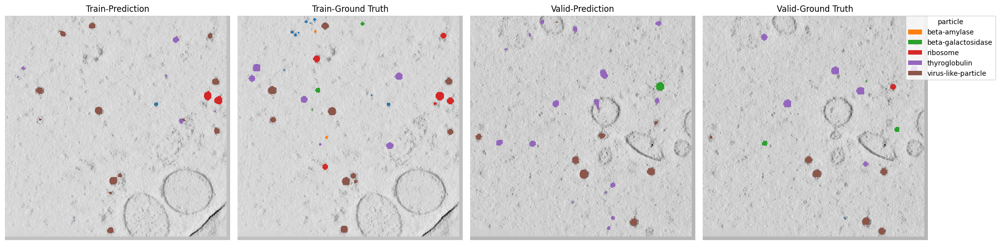

Train-Epoch: 1, Loss: 0.6936074962218602: : 60it [00:07,  7.91it/s]                      
Train-nshuffle-Epoch: 1, Loss: 0.6910739031822785: 100%|██████████| 460/460 [00:05<00:00, 79.95it/s] 


EPOCH: 1, TRAIN_SCORE: 0.22866786034716974, TRAIN_SCORE_LIST: [0.21407097584594834, 0.22987433622803385, 0.230898240501755, 0.20191921723737186, 0.2665765319227395]


Valid-Epoch: 1, Loss: 0.7165215200056201: 100%|██████████| 184/184 [00:02<00:00, 68.93it/s] 


EPOCH: 1, VALID_SCORE: 0.2225403835994138, VALID_SCORE_LIST: [0.24853475840190553, 0.1965460087969221]


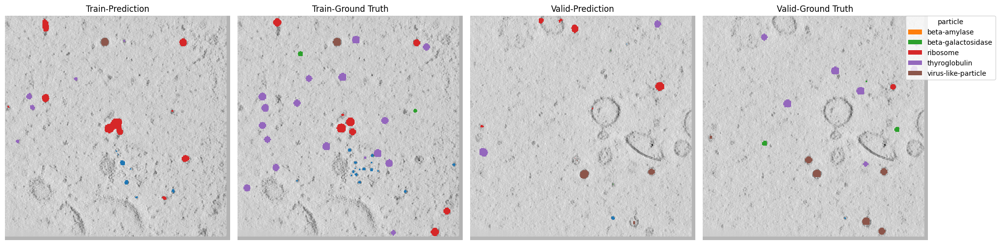

Train-Epoch: 2, Loss: 0.6712352027495702: : 60it [00:07,  7.93it/s]                      
Train-nshuffle-Epoch: 2, Loss: 0.6652576710866845: 100%|██████████| 460/460 [00:06<00:00, 76.46it/s] 


EPOCH: 2, TRAIN_SCORE: 0.37765983173433515, TRAIN_SCORE_LIST: [0.3773165968199685, 0.361604904109465, 0.40591610725679894, 0.34648698931569194, 0.39697456116975144]


Valid-Epoch: 2, Loss: 0.7023552562231603: 100%|██████████| 184/184 [00:02<00:00, 71.46it/s]


EPOCH: 2, VALID_SCORE: 0.32589594268832783, VALID_SCORE_LIST: [0.3414349241335638, 0.31035696124309187]


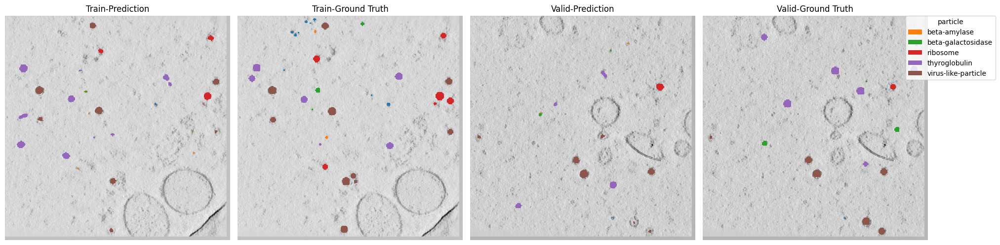

Train-Epoch: 3, Loss: 0.645823719104131: : 60it [00:07,  7.90it/s]                       
Train-nshuffle-Epoch: 3, Loss: 0.7079680098139721: 100%|██████████| 460/460 [00:05<00:00, 79.90it/s] 


EPOCH: 3, TRAIN_SCORE: 0.22113958910830922, TRAIN_SCORE_LIST: [0.2095972821152807, 0.29372731183754996, 0.25529578692413274, 0.24693488597826627, 0.10014267868631632]


Valid-Epoch: 3, Loss: 0.7369720741458561: 100%|██████████| 184/184 [00:02<00:00, 70.12it/s] 


EPOCH: 3, VALID_SCORE: 0.13896491643745323, VALID_SCORE_LIST: [0.14383294345236994, 0.13409688942253656]


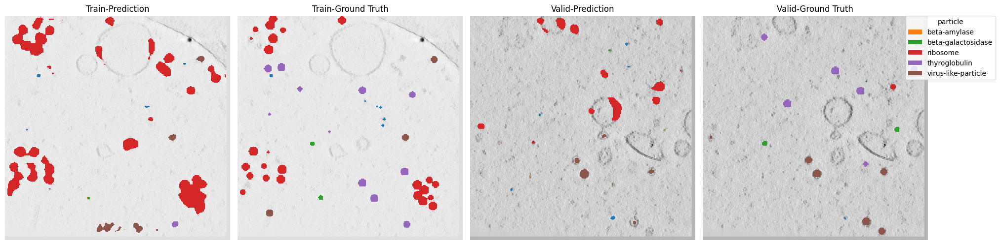

Train-Epoch: 4, Loss: 0.6334472795327505: : 60it [00:07,  7.82it/s]                      
Train-nshuffle-Epoch: 4, Loss: 0.6904089515623839: 100%|██████████| 460/460 [00:05<00:00, 78.28it/s] 


EPOCH: 4, TRAIN_SCORE: 0.6639708184407912, TRAIN_SCORE_LIST: [0.7760481087193777, 0.6594035758091528, 0.642231849913663, 0.6606462544766613, 0.5815243032851012]


Valid-Epoch: 4, Loss: 0.7379914428228918: 100%|██████████| 184/184 [00:02<00:00, 68.50it/s] 


EPOCH: 4, VALID_SCORE: 0.43784949093424974, VALID_SCORE_LIST: [0.46866570164948057, 0.40703328021901886]


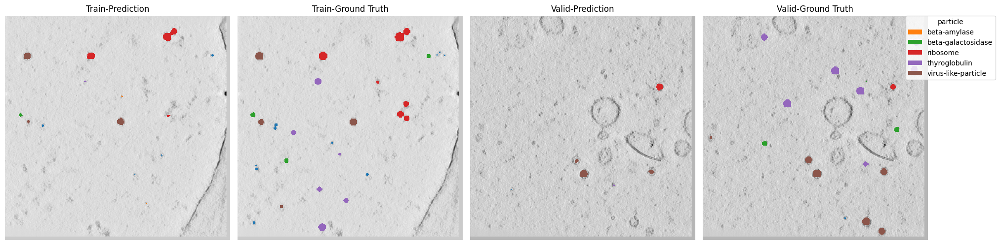

Train-Epoch: 5, Loss: 0.6145327270030976: : 60it [00:07,  7.83it/s]                      
Train-nshuffle-Epoch: 5, Loss: 0.6733579024024632: 100%|██████████| 460/460 [00:05<00:00, 77.41it/s] 


EPOCH: 5, TRAIN_SCORE: 0.412691994247401, TRAIN_SCORE_LIST: [0.44023034897225227, 0.43882174502367083, 0.4026494785973601, 0.4558810257080937, 0.32587737293562824]


Valid-Epoch: 5, Loss: 0.7257571162089057: 100%|██████████| 184/184 [00:02<00:00, 72.99it/s] 


EPOCH: 5, VALID_SCORE: 0.21391172276724296, VALID_SCORE_LIST: [0.1965532987112126, 0.23127014682327335]


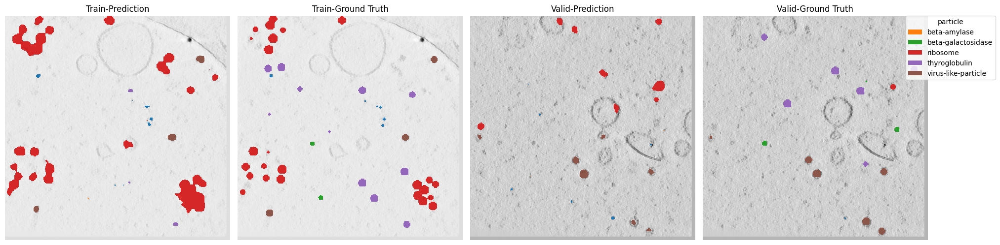

Train-Epoch: 6, Loss: 0.5949385056893031: : 60it [00:07,  7.81it/s]                      
Train-nshuffle-Epoch: 6, Loss: 0.6231579621200977: 100%|██████████| 460/460 [00:05<00:00, 77.92it/s] 


EPOCH: 6, TRAIN_SCORE: 0.24904313408600642, TRAIN_SCORE_LIST: [0.22122979325605144, 0.2410994190071662, 0.30679461511120565, 0.2426087069434281, 0.23348313611218077]


Valid-Epoch: 6, Loss: 0.6897401025761729: 100%|██████████| 184/184 [00:02<00:00, 71.12it/s] 


EPOCH: 6, VALID_SCORE: 0.17395547243272758, VALID_SCORE_LIST: [0.2043326703424986, 0.14357827452295652]


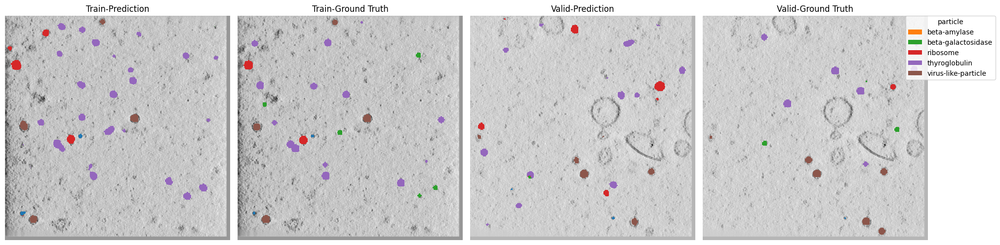

Train-Epoch: 7, Loss: 0.5922361453374226: : 60it [00:07,  7.82it/s]                      
Train-nshuffle-Epoch: 7, Loss: 0.7539164729740309: 100%|██████████| 460/460 [00:05<00:00, 79.76it/s] 


EPOCH: 7, TRAIN_SCORE: 0.5063006957236655, TRAIN_SCORE_LIST: [0.45961463632883504, 0.5717635379163817, 0.5942068276156007, 0.40794885081775395, 0.4979696259397568]


Valid-Epoch: 7, Loss: 0.7495942951544471: 100%|██████████| 184/184 [00:02<00:00, 72.94it/s] 


EPOCH: 7, VALID_SCORE: 0.2167929874299283, VALID_SCORE_LIST: [0.26814485138494254, 0.16544112347491408]


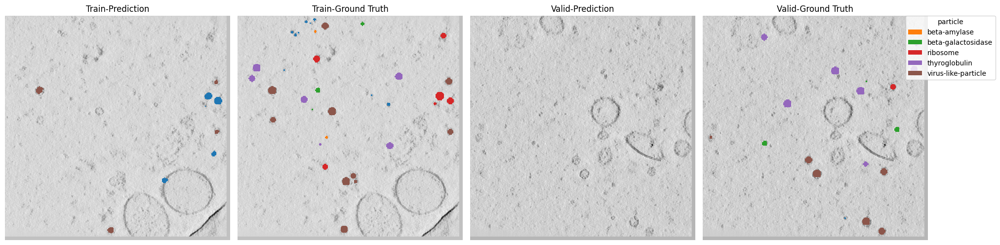

Train-Epoch: 8, Loss: 0.5789138307174047: : 60it [00:07,  7.84it/s]                      
Train-nshuffle-Epoch: 8, Loss: 0.6113838276137477: 100%|██████████| 460/460 [00:05<00:00, 80.99it/s] 


EPOCH: 8, TRAIN_SCORE: 0.5402796736420896, TRAIN_SCORE_LIST: [0.5638708669485127, 0.543331459310002, 0.5284410322504749, 0.5521402303724968, 0.5136147793289616]


Valid-Epoch: 8, Loss: 0.7112927699218625: 100%|██████████| 184/184 [00:02<00:00, 69.78it/s] 


EPOCH: 8, VALID_SCORE: 0.2972541371187729, VALID_SCORE_LIST: [0.2563978073236347, 0.33811046691391106]


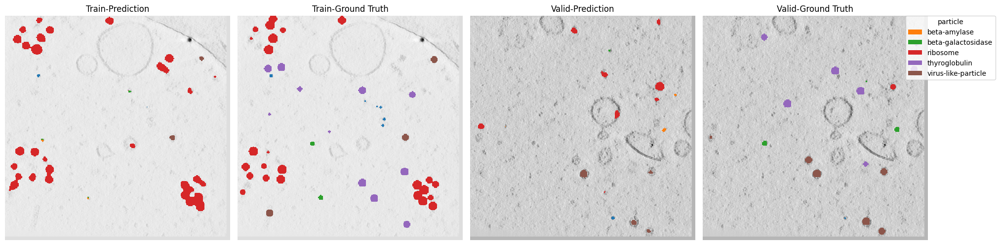

Train-Epoch: 9, Loss: 0.5612841834624608: : 60it [00:07,  7.83it/s]                      
Train-nshuffle-Epoch: 9, Loss: 0.5913746205360993: 100%|██████████| 460/460 [00:05<00:00, 80.29it/s] 


EPOCH: 9, TRAIN_SCORE: 0.29445161737940617, TRAIN_SCORE_LIST: [0.28904674575220646, 0.3046303233161868, 0.3129287738842524, 0.26048493407226764, 0.30516730987211765]


Valid-Epoch: 9, Loss: 0.7131020935333293: 100%|██████████| 184/184 [00:02<00:00, 70.54it/s] 


EPOCH: 9, VALID_SCORE: 0.23397531807293837, VALID_SCORE_LIST: [0.25785277350006536, 0.21009786264581135]


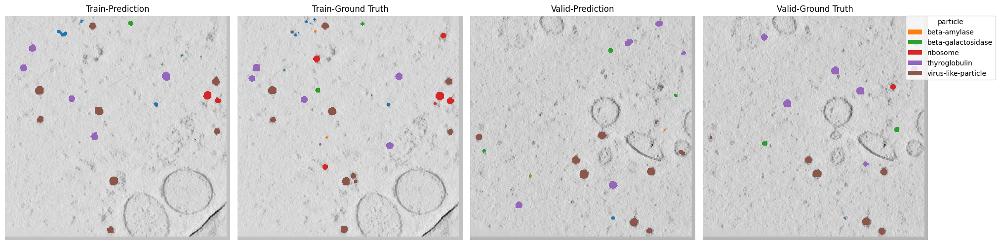

Train-Epoch: 10, Loss: 0.544030471642812: : 60it [00:07,  7.77it/s]                       
Train-nshuffle-Epoch: 10, Loss: 0.5257538327704305: 100%|██████████| 460/460 [00:05<00:00, 79.94it/s]  


EPOCH: 10, TRAIN_SCORE: 0.49104671531760635, TRAIN_SCORE_LIST: [0.5118430988390984, 0.5011288393808252, 0.48449791696457334, 0.45426448963478994, 0.5034992317687447]


Valid-Epoch: 10, Loss: 0.6861441789761834: 100%|██████████| 184/184 [00:02<00:00, 73.25it/s] 


EPOCH: 10, VALID_SCORE: 0.2969328181499466, VALID_SCORE_LIST: [0.3109944443341884, 0.2828711919657048]


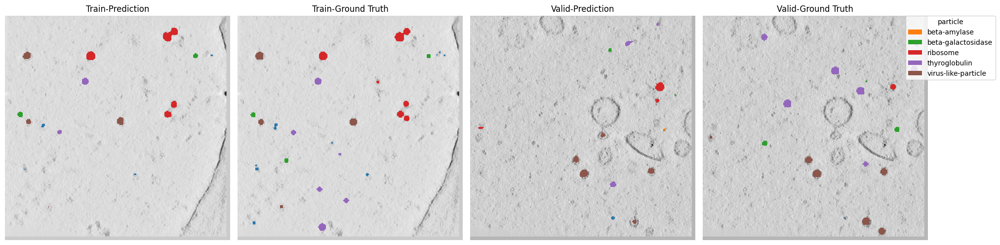

Train-Epoch: 11, Loss: 0.5241100420554479: : 60it [00:07,  7.78it/s]                      
Train-nshuffle-Epoch: 11, Loss: 0.5472714298445246: 100%|██████████| 460/460 [00:05<00:00, 79.37it/s]  


EPOCH: 11, TRAIN_SCORE: 0.6230365545189919, TRAIN_SCORE_LIST: [0.62024039849819, 0.6517588604284336, 0.633233259926815, 0.586232614236685, 0.6237176395048359]


Valid-Epoch: 11, Loss: 0.6910762323633485: 100%|██████████| 184/184 [00:02<00:00, 72.46it/s] 


EPOCH: 11, VALID_SCORE: 0.32005438831923005, VALID_SCORE_LIST: [0.3418715100414397, 0.2982372665970205]


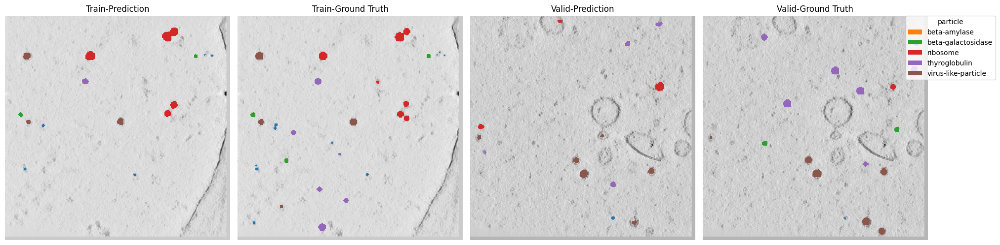

Train-Epoch: 12, Loss: 0.5256201585133871: : 60it [00:07,  7.86it/s]                      
Train-nshuffle-Epoch: 12, Loss: 0.5727000823487406: 100%|██████████| 460/460 [00:05<00:00, 77.56it/s]  


EPOCH: 12, TRAIN_SCORE: 0.28911934232115044, TRAIN_SCORE_LIST: [0.286385807901798, 0.26926127662008803, 0.28906007021698743, 0.2742600834045429, 0.32662947346233573]


Valid-Epoch: 12, Loss: 0.7115963111105172: 100%|██████████| 184/184 [00:02<00:00, 70.05it/s] 


EPOCH: 12, VALID_SCORE: 0.23514984170764047, VALID_SCORE_LIST: [0.24010871859056548, 0.23019096482471543]


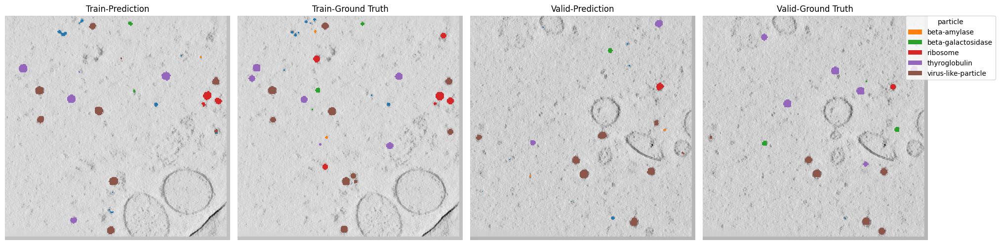

Train-Epoch: 13, Loss: 0.5163721640904745: : 60it [00:07,  7.75it/s]                       
Train-nshuffle-Epoch: 13, Loss: 0.5165250004633614: 100%|██████████| 460/460 [00:06<00:00, 76.18it/s]  


EPOCH: 13, TRAIN_SCORE: 0.29262020464013055, TRAIN_SCORE_LIST: [0.2678833100997868, 0.3117089072069258, 0.34094003975413845, 0.2542493106527596, 0.288319455487042]


Valid-Epoch: 13, Loss: 0.677144599997479: 100%|██████████| 184/184 [00:02<00:00, 68.51it/s]  


EPOCH: 13, VALID_SCORE: 0.2199600154734721, VALID_SCORE_LIST: [0.2607459427789638, 0.17917408816798044]


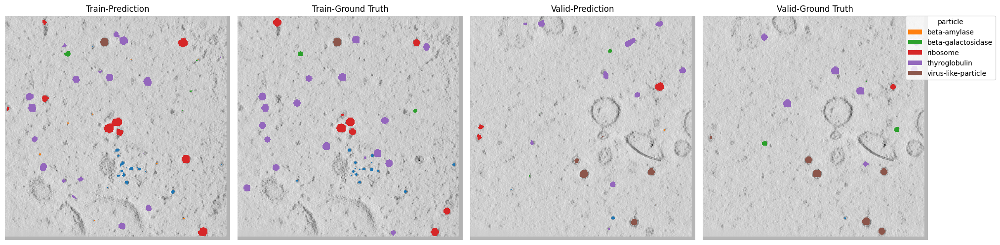

Train-Epoch: 14, Loss: 0.40204023122787474: : 60it [00:07,  7.86it/s]                      
Train-nshuffle-Epoch: 14, Loss: 0.4657792123763458: 100%|██████████| 460/460 [00:06<00:00, 74.56it/s]  


EPOCH: 14, TRAIN_SCORE: 0.09388788358402902, TRAIN_SCORE_LIST: [0.07456440481310347, 0.04690427498705626, 0.10083497123023152, 0.09666980929916127, 0.1504659575905926]


Valid-Epoch: 14, Loss: 0.5024036094546318: 100%|██████████| 184/184 [00:02<00:00, 67.52it/s] 


EPOCH: 14, VALID_SCORE: 0.057456201639496995, VALID_SCORE_LIST: [0.05626637052060845, 0.05864603275838554]


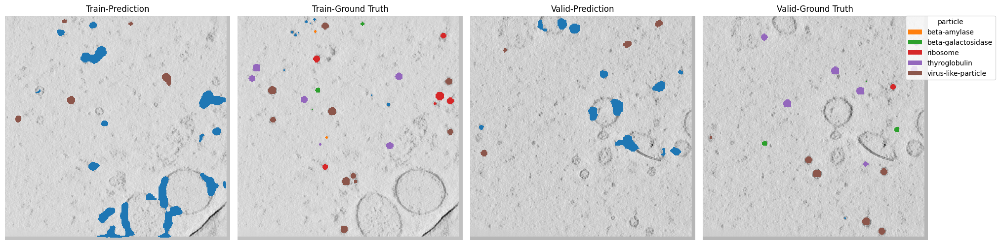

Train-Epoch: 15, Loss: 0.4279147833585739: : 60it [00:07,  7.81it/s]                       
Train-nshuffle-Epoch: 15, Loss: 0.4337828024573948: 100%|██████████| 460/460 [00:05<00:00, 79.88it/s]  


EPOCH: 15, TRAIN_SCORE: 0.08580421677084099, TRAIN_SCORE_LIST: [0.060857671019515065, 0.0608039786255148, 0.14253336676324097, 0.08540651449089509, 0.07941955295503907]


Valid-Epoch: 15, Loss: 0.46547455826531287: 100%|██████████| 184/184 [00:02<00:00, 69.26it/s] 


EPOCH: 15, VALID_SCORE: 0.05247064017721323, VALID_SCORE_LIST: [0.06285348735290429, 0.04208779300152216]


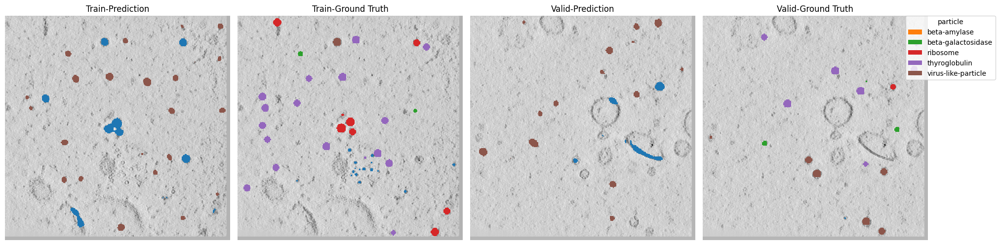

Train-Epoch: 16, Loss: 0.42738230923811593: : 60it [00:07,  7.92it/s]                      
Train-nshuffle-Epoch: 16, Loss: 0.4365000923042712: 100%|██████████| 460/460 [00:05<00:00, 78.65it/s]  


EPOCH: 16, TRAIN_SCORE: 0.054562646175435825, TRAIN_SCORE_LIST: [0.046524356869184456, 0.03749081107571673, 0.08238030626090329, 0.060136054421768705, 0.04628170224960595]


Valid-Epoch: 16, Loss: 0.4618068026459735: 100%|██████████| 184/184 [00:02<00:00, 66.84it/s]  


EPOCH: 16, VALID_SCORE: 0.02128374219967161, VALID_SCORE_LIST: [0.03199698851872765, 0.010570495880615574]


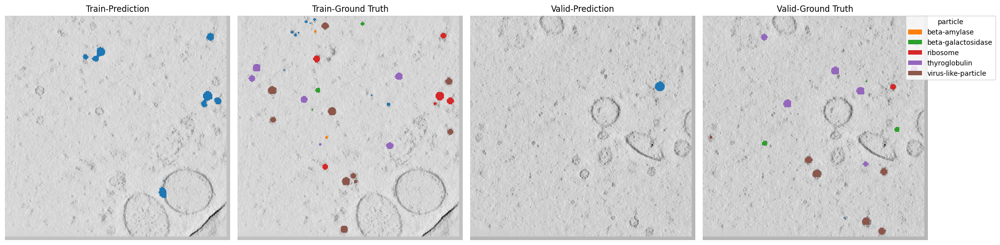

Train-Epoch: 17, Loss: 0.43950331111749014: : 60it [00:07,  7.82it/s]                      
Train-nshuffle-Epoch: 17, Loss: 0.43455898049085034: 100%|██████████| 460/460 [00:05<00:00, 77.68it/s] 


EPOCH: 17, TRAIN_SCORE: 0.045289232893726876, TRAIN_SCORE_LIST: [0.03292119767615075, 0.036105522021014975, 0.06865219586067643, 0.06140759729666745, 0.02735965161412477]


Valid-Epoch: 17, Loss: 0.46232084444035654: 100%|██████████| 184/184 [00:02<00:00, 70.45it/s] 


EPOCH: 17, VALID_SCORE: 0.015623777663718245, VALID_SCORE_LIST: [0.017742987606001303, 0.01350456772143519]


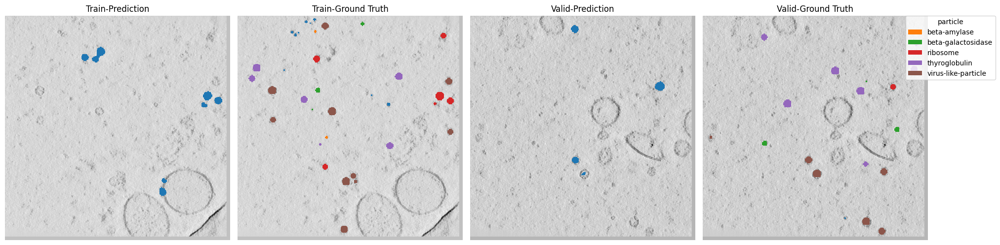

Train-Epoch: 18, Loss: 0.4373543322086334: : 60it [00:07,  7.86it/s]                       
Train-nshuffle-Epoch: 18, Loss: 0.42686412204866825: 100%|██████████| 460/460 [00:05<00:00, 81.69it/s] 


EPOCH: 18, TRAIN_SCORE: 0.0698653426949029, TRAIN_SCORE_LIST: [0.06951188346537183, 0.06975009324878775, 0.089564336372847, 0.06509572901325478, 0.055404671374253124]


Valid-Epoch: 18, Loss: 0.4549703397180723: 100%|██████████| 184/184 [00:02<00:00, 70.43it/s]  


EPOCH: 18, VALID_SCORE: 0.031334192617279204, VALID_SCORE_LIST: [0.03268602191886176, 0.029982363315696644]


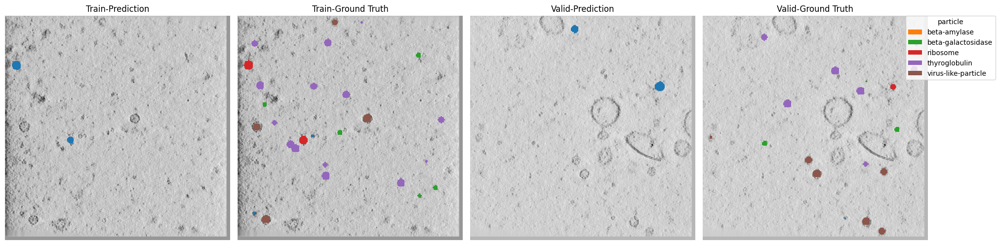

Train-Epoch: 19, Loss: 0.43204758564631146: : 60it [00:07,  7.89it/s]                      
Train-nshuffle-Epoch: 19, Loss: 0.42742769705212635: 100%|██████████| 460/460 [00:05<00:00, 78.58it/s] 


EPOCH: 19, TRAIN_SCORE: 0.09269663883219387, TRAIN_SCORE_LIST: [0.10138248847926269, 0.07611940298507462, 0.12300185091704527, 0.08374384236453201, 0.07923560941505477]


Valid-Epoch: 19, Loss: 0.4506965516054112: 100%|██████████| 184/184 [00:02<00:00, 71.89it/s]  


EPOCH: 19, VALID_SCORE: 0.03604815936222487, VALID_SCORE_LIST: [0.0421139554087531, 0.029982363315696644]


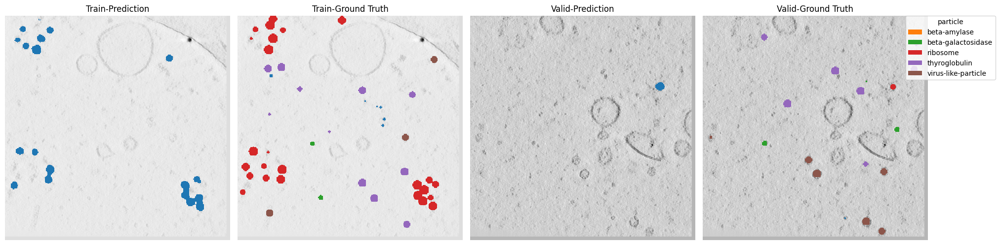

Train-Epoch: 20, Loss: 0.43667840758959453: : 60it [00:07,  7.90it/s]                      
Train-nshuffle-Epoch: 20, Loss: 0.4636548004720522: 100%|██████████| 460/460 [00:05<00:00, 77.46it/s]  


EPOCH: 20, TRAIN_SCORE: 0.12166815342098221, TRAIN_SCORE_LIST: [0.12903225806451613, 0.11416361416361416, 0.13307240704500975, 0.1157337367624811, 0.11633875106928997]


Valid-Epoch: 20, Loss: 0.46816837722840515: 100%|██████████| 184/184 [00:02<00:00, 68.07it/s] 


EPOCH: 20, VALID_SCORE: 0.12314843441501394, VALID_SCORE_LIST: [0.12281018602131118, 0.12348668280871669]


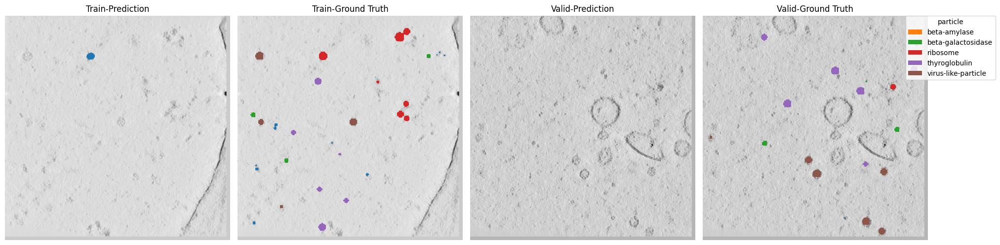

Train-Epoch: 21, Loss: 0.4274739811817805: : 60it [00:07,  7.88it/s]                       
Train-nshuffle-Epoch: 21, Loss: 0.43110086632811506: 100%|██████████| 460/460 [00:05<00:00, 77.53it/s] 


EPOCH: 21, TRAIN_SCORE: 0.07450620332238185, TRAIN_SCORE_LIST: [0.0664928292046936, 0.06082289803220036, 0.10979547900968782, 0.08220834172879307, 0.053211468636534365]


Valid-Epoch: 21, Loss: 0.4588241350391637: 100%|██████████| 184/184 [00:02<00:00, 74.33it/s]  


EPOCH: 21, VALID_SCORE: 0.039594136495209195, VALID_SCORE_LIST: [0.04155844155844156, 0.03762983143197683]


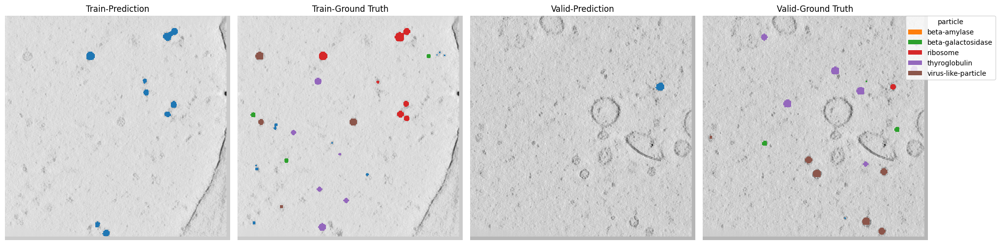

Train-Epoch: 22, Loss: 0.42277392248312634: : 60it [00:07,  7.90it/s]                      
Train-nshuffle-Epoch: 22, Loss: 0.42560985749182495: 100%|██████████| 460/460 [00:05<00:00, 81.74it/s] 


EPOCH: 22, TRAIN_SCORE: 0.07265422338209934, TRAIN_SCORE_LIST: [0.06985738457819676, 0.052133912599028887, 0.11446769790718835, 0.07234874626178975, 0.054463375564292996]


Valid-Epoch: 22, Loss: 0.45417584219704504: 100%|██████████| 184/184 [00:02<00:00, 75.59it/s] 


EPOCH: 22, VALID_SCORE: 0.027943213916037747, VALID_SCORE_LIST: [0.031244778613199665, 0.024641649218875825]


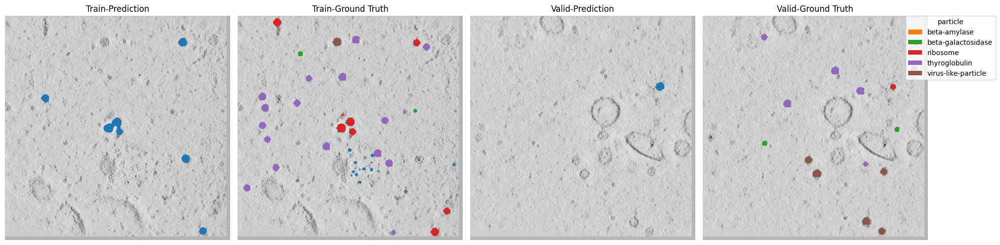

Train-Epoch: 23, Loss: 0.42191894153753917: : 60it [00:07,  7.84it/s]                      
Train-nshuffle-Epoch: 23, Loss: 0.43264952483384506: 100%|██████████| 460/460 [00:05<00:00, 78.75it/s] 


EPOCH: 23, TRAIN_SCORE: 0.037880777419878865, TRAIN_SCORE_LIST: [0.02953953084274544, 0.024840983324737838, 0.06497849976110846, 0.034577650155539603, 0.03546722301526299]


Valid-Epoch: 23, Loss: 0.4697911486677501: 100%|██████████| 184/184 [00:02<00:00, 70.42it/s]  


EPOCH: 23, VALID_SCORE: 0.013239448681021844, VALID_SCORE_LIST: [0.013887470642295516, 0.01259142671974817]


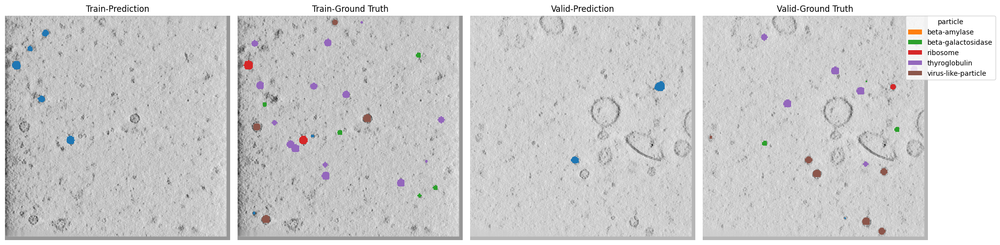

Train-Epoch: 24, Loss: 0.4262307564417521: : 60it [00:07,  7.87it/s]                       
Train-nshuffle-Epoch: 24, Loss: 0.4220953318087951: 100%|██████████| 460/460 [00:05<00:00, 79.00it/s]  


EPOCH: 24, TRAIN_SCORE: 0.10105638721287728, TRAIN_SCORE_LIST: [0.12289156626506023, 0.08912188728702489, 0.11789181692094312, 0.07513544339891644, 0.10024122219244172]


Valid-Epoch: 24, Loss: 0.4540418933915055: 100%|██████████| 184/184 [00:02<00:00, 73.38it/s]  


EPOCH: 24, VALID_SCORE: 0.06970447974940311, VALID_SCORE_LIST: [0.07131817178185029, 0.06809078771695594]


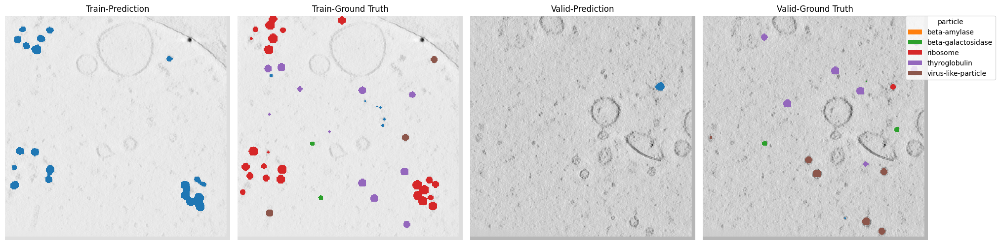

Train-Epoch: 25, Loss: 0.44174615740776063: : 60it [00:07,  7.95it/s]                      
Train-nshuffle-Epoch: 25, Loss: 0.44526226987009465: 100%|██████████| 460/460 [00:06<00:00, 74.58it/s]


EPOCH: 25, TRAIN_SCORE: 0.04334088497996812, TRAIN_SCORE_LIST: [0.03939745075318656, 0.03508369639990828, 0.07058280793479933, 0.03630151612214393, 0.03533895368980251]


Valid-Epoch: 25, Loss: 0.46950040822443756: 100%|██████████| 184/184 [00:02<00:00, 69.86it/s] 


EPOCH: 25, VALID_SCORE: 0.016488845780795344, VALID_SCORE_LIST: [0.0211999445753083, 0.01177774698628239]


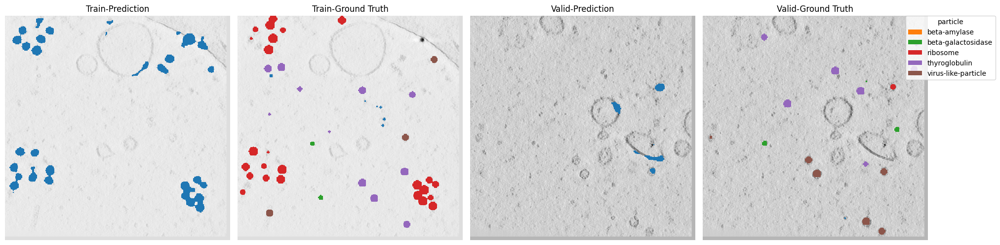

Train-Epoch: 26, Loss: 0.436433337132136: : 60it [00:07,  7.83it/s]                        
Train-nshuffle-Epoch: 26, Loss: 0.42732257117395817: 100%|██████████| 460/460 [00:06<00:00, 74.22it/s] 


EPOCH: 26, TRAIN_SCORE: 0.06601661092409164, TRAIN_SCORE_LIST: [0.06912442396313365, 0.05634736493205171, 0.09474270852684377, 0.05954919281145294, 0.05031936438697616]


Valid-Epoch: 26, Loss: 0.45785418768291886: 100%|██████████| 184/184 [00:02<00:00, 66.07it/s] 


EPOCH: 26, VALID_SCORE: 0.02315118620722746, VALID_SCORE_LIST: [0.026557889255337617, 0.019744483159117306]


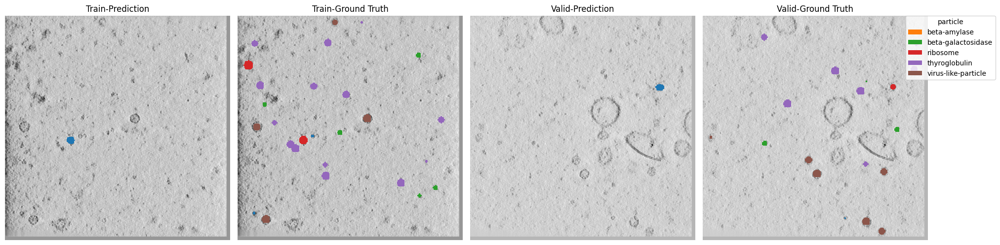

Train-Epoch: 27, Loss: 0.42956446210543314: : 60it [00:07,  7.82it/s]                      
Train-nshuffle-Epoch: 27, Loss: 0.42447646493497104: 100%|██████████| 460/460 [00:06<00:00, 75.96it/s] 


EPOCH: 27, TRAIN_SCORE: 0.0803499636153156, TRAIN_SCORE_LIST: [0.08149568552253114, 0.06563706563706563, 0.11789181692094312, 0.06821829855537721, 0.0685069514406609]


Valid-Epoch: 27, Loss: 0.4520085097655006: 100%|██████████| 184/184 [00:02<00:00, 69.53it/s]  


EPOCH: 27, VALID_SCORE: 0.03169387373880725, VALID_SCORE_LIST: [0.03340538416191786, 0.029982363315696644]


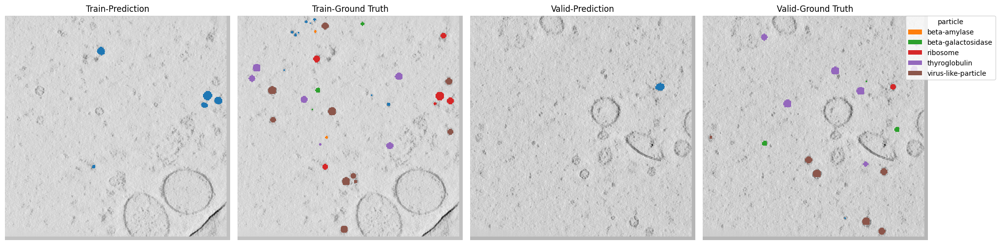

Train-Epoch: 28, Loss: 0.4295424292484919: : 60it [00:07,  7.88it/s]                       
Train-nshuffle-Epoch: 28, Loss: 0.4240602037181025: 100%|██████████| 460/460 [00:05<00:00, 77.38it/s]  


EPOCH: 28, TRAIN_SCORE: 0.1025189108353903, TRAIN_SCORE_LIST: [0.12047743379336069, 0.07292055203282356, 0.1287228672387683, 0.09394860458690245, 0.09652509652509653]


Valid-Epoch: 28, Loss: 0.45193258834921796: 100%|██████████| 184/184 [00:02<00:00, 70.97it/s] 


EPOCH: 28, VALID_SCORE: 0.05867791313811897, VALID_SCORE_LIST: [0.06005740781629498, 0.057298418459942956]


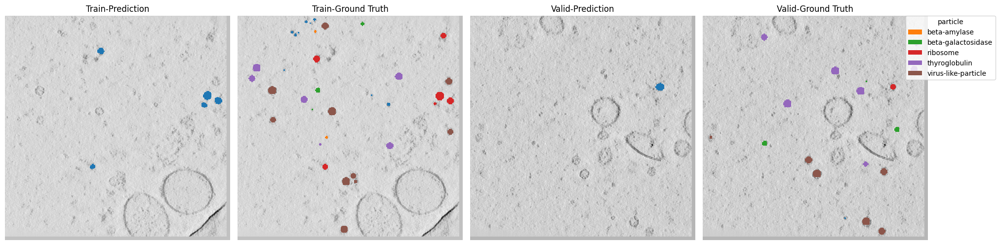

Train-Epoch: 29, Loss: 0.423092391093572: : 60it [00:07,  7.81it/s]                        
Train-nshuffle-Epoch: 29, Loss: 0.4212111506773078: 100%|██████████| 460/460 [00:05<00:00, 79.27it/s]  


EPOCH: 29, TRAIN_SCORE: 0.08258103307428229, TRAIN_SCORE_LIST: [0.093631669535284, 0.07279096924873493, 0.10491428571428571, 0.06618748128182092, 0.07538075959128589]


Valid-Epoch: 29, Loss: 0.45382379999627237: 100%|██████████| 184/184 [00:02<00:00, 69.07it/s] 


EPOCH: 29, VALID_SCORE: 0.044129231761982704, VALID_SCORE_LIST: [0.04542651593011306, 0.04283194759385236]


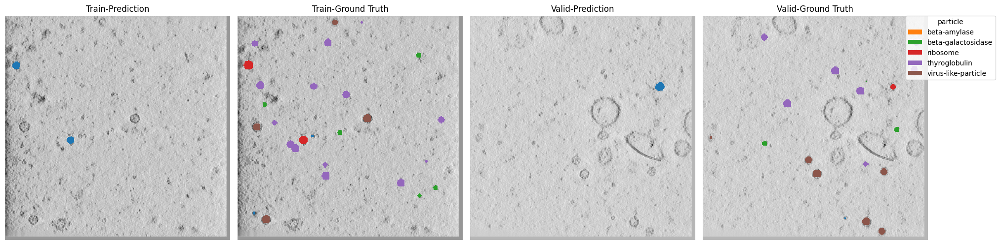

Train-Epoch: 30, Loss: 0.4263838509718577: : 60it [00:07,  7.92it/s]                       
Train-nshuffle-Epoch: 30, Loss: 0.46538825462693756: 100%|██████████| 460/460 [00:05<00:00, 78.40it/s] 


EPOCH: 30, TRAIN_SCORE: 0.12837001962005593, TRAIN_SCORE_LIST: [0.1360320075311838, 0.1349206349206349, 0.13394153016794524, 0.10424710424710425, 0.1327088212334114]


Valid-Epoch: 30, Loss: 0.46749813433574594: 100%|██████████| 184/184 [00:02<00:00, 73.25it/s] 


EPOCH: 30, VALID_SCORE: 0.11711281357969056, VALID_SCORE_LIST: [0.10470181763557158, 0.12952380952380954]


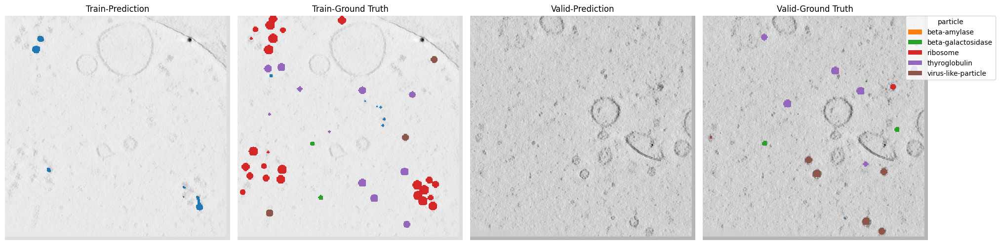

Train-Epoch: 31, Loss: 0.4244627018769582: : 60it [00:07,  7.88it/s]                       
Train-nshuffle-Epoch: 31, Loss: 0.42007878824420597: 100%|██████████| 460/460 [00:05<00:00, 77.48it/s] 


EPOCH: 31, TRAIN_SCORE: 0.08469766380108798, TRAIN_SCORE_LIST: [0.09264305177111716, 0.07123809523809524, 0.1163176446195314, 0.07249466950959489, 0.07079485786710121]


Valid-Epoch: 31, Loss: 0.45082468992989994: 100%|██████████| 184/184 [00:02<00:00, 67.24it/s] 


EPOCH: 31, VALID_SCORE: 0.03957611326866478, VALID_SCORE_LIST: [0.04618519357029658, 0.032967032967032975]


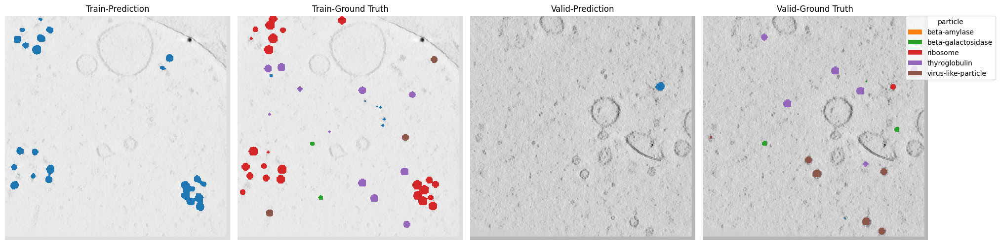

Train-Epoch: 32, Loss: 0.42261359294255574: : 60it [00:07,  7.73it/s]                      
Train-nshuffle-Epoch: 32, Loss: 0.420973242106645: 100%|██████████| 460/460 [00:07<00:00, 65.47it/s]  


EPOCH: 32, TRAIN_SCORE: 0.10043665339779129, TRAIN_SCORE_LIST: [0.1107041107041107, 0.08699360341151387, 0.12300185091704527, 0.08262150220913109, 0.0988621997471555]


Valid-Epoch: 32, Loss: 0.44916335493326187: 100%|██████████| 184/184 [00:02<00:00, 65.21it/s] 


EPOCH: 32, VALID_SCORE: 0.05741303613644039, VALID_SCORE_LIST: [0.05741303613644039, 0.05741303613644039]


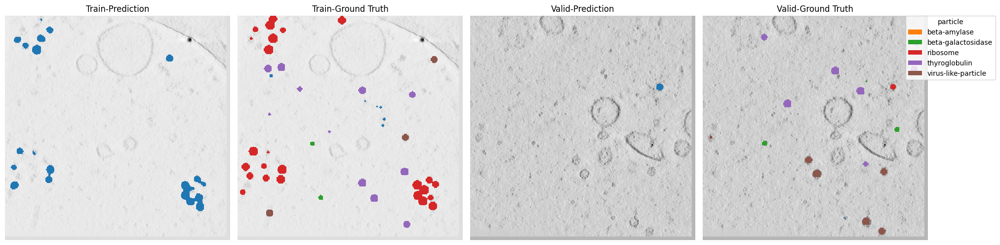

Train-Epoch: 33, Loss: 0.415206316113472: : 60it [00:07,  7.84it/s]                        
Train-nshuffle-Epoch: 33, Loss: 0.41946703843448474: 100%|██████████| 460/460 [00:06<00:00, 75.00it/s] 


EPOCH: 33, TRAIN_SCORE: 0.06290707076188777, TRAIN_SCORE_LIST: [0.0760512973456606, 0.051515151515151514, 0.07578008915304608, 0.05529534218058808, 0.0558934736149926]


Valid-Epoch: 33, Loss: 0.45526469693235727: 100%|██████████| 184/184 [00:02<00:00, 66.50it/s] 


EPOCH: 33, VALID_SCORE: 0.02733517656351166, VALID_SCORE_LIST: [0.024641649218875825, 0.030028703908147495]


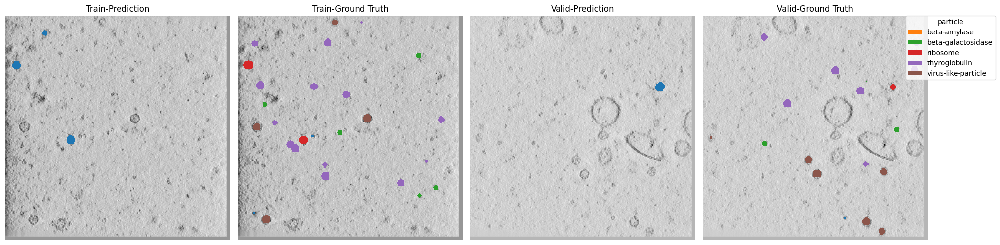

Train-Epoch: 34, Loss: 0.42333846986293794: : 60it [00:07,  7.87it/s]                      
Train-nshuffle-Epoch: 34, Loss: 0.4207652476818665: 100%|██████████| 460/460 [00:06<00:00, 76.07it/s]  


EPOCH: 34, TRAIN_SCORE: 0.05969729269917251, TRAIN_SCORE_LIST: [0.05457463884430177, 0.04069035021415974, 0.09675583380762663, 0.06244897959183674, 0.044016661037937645]


Valid-Epoch: 34, Loss: 0.4518188150680583: 100%|██████████| 184/184 [00:02<00:00, 68.81it/s]  


EPOCH: 34, VALID_SCORE: 0.02340138190233801, VALID_SCORE_LIST: [0.029508765839264012, 0.017293997965412002]


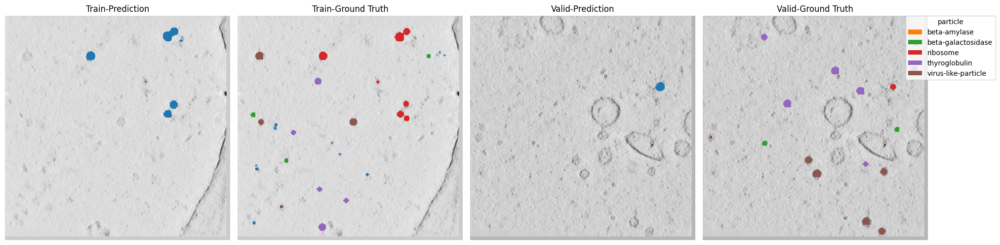

Train-Epoch: 35, Loss: 0.42114870647589364: : 60it [00:07,  7.85it/s]                      
Train-nshuffle-Epoch: 35, Loss: 0.4179970146521278: 100%|██████████| 460/460 [00:06<00:00, 73.83it/s]  


EPOCH: 35, TRAIN_SCORE: 0.07450505944754991, TRAIN_SCORE_LIST: [0.08521303258145363, 0.054542384329618374, 0.10229552039224425, 0.07010309278350516, 0.06037126715092817]


Valid-Epoch: 35, Loss: 0.4456743555872337: 100%|██████████| 184/184 [00:02<00:00, 62.80it/s]  


EPOCH: 35, VALID_SCORE: 0.034622123453809266, VALID_SCORE_LIST: [0.04128946787370281, 0.02795477903391572]


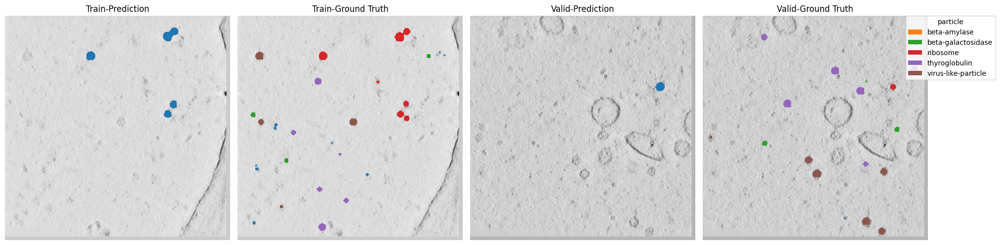

Train-Epoch: 36, Loss: 0.41867232223351797: : 60it [00:07,  7.94it/s]                      
Train-nshuffle-Epoch: 36, Loss: 0.41822038694568303: 100%|██████████| 460/460 [00:06<00:00, 73.66it/s] 


EPOCH: 36, TRAIN_SCORE: 0.08762067551239483, TRAIN_SCORE_LIST: [0.09129967776584318, 0.07609101081685939, 0.11933219502940619, 0.07750759878419454, 0.07387289516567083]


Valid-Epoch: 36, Loss: 0.444403851809709: 100%|██████████| 184/184 [00:02<00:00, 66.68it/s]  


EPOCH: 36, VALID_SCORE: 0.04360063446636306, VALID_SCORE_LIST: [0.048652516098259005, 0.03854875283446712]


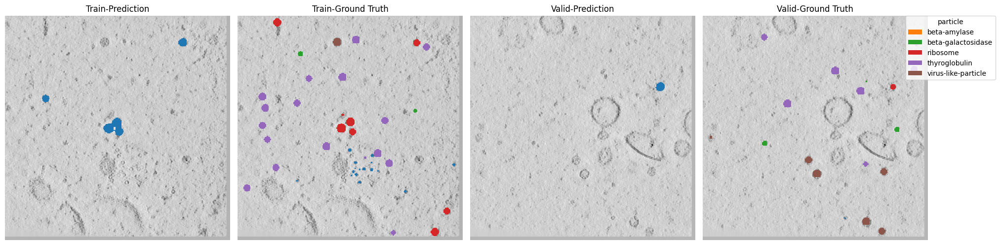

Train-Epoch: 37, Loss: 0.4188162157932917: : 60it [00:07,  7.83it/s]                       
Train-nshuffle-Epoch: 37, Loss: 0.41784904443699383: 100%|██████████| 460/460 [00:06<00:00, 73.95it/s] 


EPOCH: 37, TRAIN_SCORE: 0.06731403900094907, TRAIN_SCORE_LIST: [0.0734341252699784, 0.054330457015020775, 0.09300911854103343, 0.05816937553464498, 0.0576271186440678]


Valid-Epoch: 37, Loss: 0.44856266936530237: 100%|██████████| 184/184 [00:02<00:00, 66.15it/s]


EPOCH: 37, VALID_SCORE: 0.034210092243665384, VALID_SCORE_LIST: [0.03843782117163413, 0.029982363315696644]


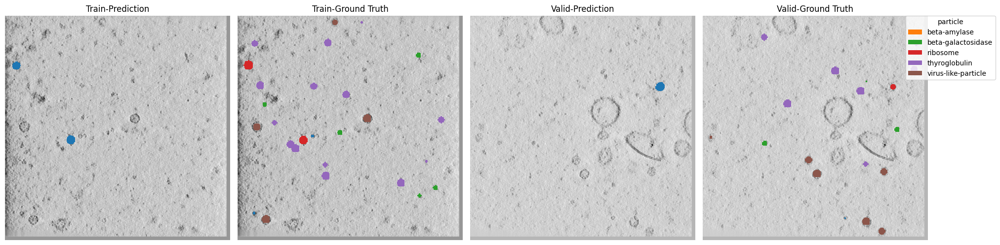

Train-Epoch: 38, Loss: 0.417903870344162: : 60it [00:07,  7.78it/s]                        
Train-nshuffle-Epoch: 38, Loss: 0.41753056619478307: 100%|██████████| 460/460 [00:06<00:00, 68.11it/s]


EPOCH: 38, TRAIN_SCORE: 0.06718250672317647, TRAIN_SCORE_LIST: [0.0734341252699784, 0.05070643642072214, 0.08811942774206925, 0.05816937553464498, 0.0654831686484676]


Valid-Epoch: 38, Loss: 0.45000539201757184: 100%|██████████| 184/184 [00:02<00:00, 68.22it/s] 


EPOCH: 38, VALID_SCORE: 0.033782291896665935, VALID_SCORE_LIST: [0.03753587988518437, 0.030028703908147495]


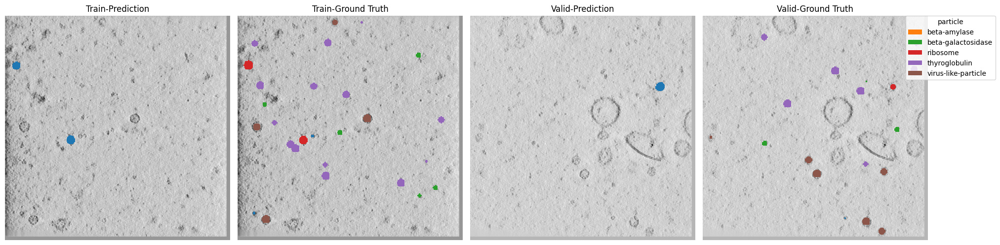

Train-Epoch: 39, Loss: 0.4165464222431183: : 60it [00:07,  7.84it/s]                       
Train-nshuffle-Epoch: 39, Loss: 0.4170623280431913: 100%|██████████| 460/460 [00:06<00:00, 72.47it/s]  


EPOCH: 39, TRAIN_SCORE: 0.07671633497894878, TRAIN_SCORE_LIST: [0.0788863109048724, 0.06563706563706563, 0.09850679741475374, 0.0636418089248278, 0.0769096920132243]


Valid-Epoch: 39, Loss: 0.4455973512452582: 100%|██████████| 184/184 [00:02<00:00, 66.81it/s] 


EPOCH: 39, VALID_SCORE: 0.04568578464879583, VALID_SCORE_LIST: [0.0471151423532376, 0.044256426944354055]


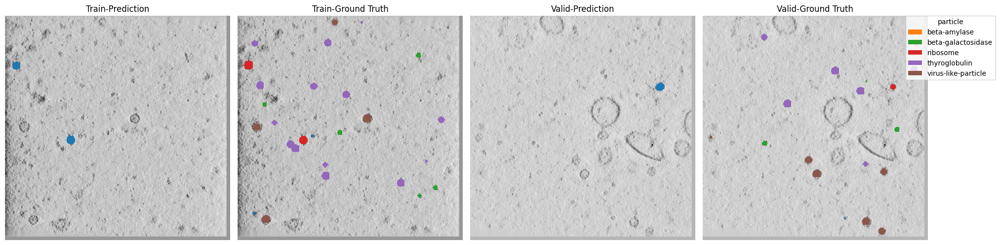

Train-Epoch: 40, Loss: 0.4204229791959127: : 60it [00:07,  7.80it/s]                       
Train-nshuffle-Epoch: 40, Loss: 0.41707753953726395: 100%|██████████| 460/460 [00:06<00:00, 73.74it/s] 


EPOCH: 40, TRAIN_SCORE: 0.07183647152966223, TRAIN_SCORE_LIST: [0.0819277108433735, 0.05337519623233909, 0.09869375907111756, 0.06476190476190477, 0.060423786739576206]


Valid-Epoch: 40, Loss: 0.45267034743143164: 100%|██████████| 184/184 [00:02<00:00, 70.12it/s] 


EPOCH: 40, VALID_SCORE: 0.02433724650475038, VALID_SCORE_LIST: [0.029508765839264012, 0.019165727170236752]


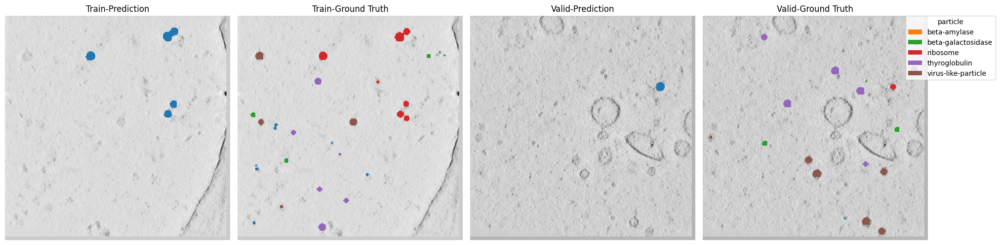

Train-Epoch: 41, Loss: 0.42112761636575063: : 60it [00:09,  6.18it/s]                      
Train-nshuffle-Epoch: 41, Loss: 0.4161683695471805: 100%|██████████| 460/460 [00:06<00:00, 73.09it/s]  


EPOCH: 41, TRAIN_SCORE: 0.08682127377956697, TRAIN_SCORE_LIST: [0.10149253731343284, 0.06340917568071615, 0.11452347929463046, 0.07634016278417063, 0.0783410138248848]


Valid-Epoch: 41, Loss: 0.44751354112573294: 100%|██████████| 184/184 [00:02<00:00, 66.45it/s] 


EPOCH: 41, VALID_SCORE: 0.040381253685131936, VALID_SCORE_LIST: [0.04649694929518199, 0.03426555807508188]


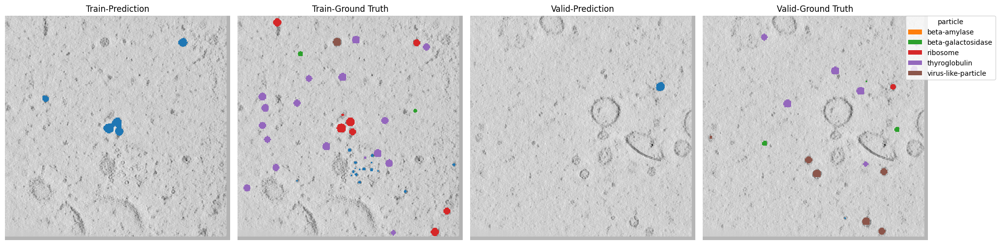

Train-Epoch: 42, Loss: 0.41695103148619334: : 60it [00:07,  7.73it/s]                      
Train-nshuffle-Epoch: 42, Loss: 0.41632572062637496: 100%|██████████| 460/460 [00:06<00:00, 72.51it/s]


EPOCH: 42, TRAIN_SCORE: 0.06571566900116353, TRAIN_SCORE_LIST: [0.0734341252699784, 0.049062049062049064, 0.08299724050095521, 0.06321660985435389, 0.059868320318481084]


Valid-Epoch: 42, Loss: 0.4521711180391519: 100%|██████████| 184/184 [00:02<00:00, 67.32it/s]  


EPOCH: 42, VALID_SCORE: 0.02494806337377367, VALID_SCORE_LIST: [0.02840434419381788, 0.02149178255372946]


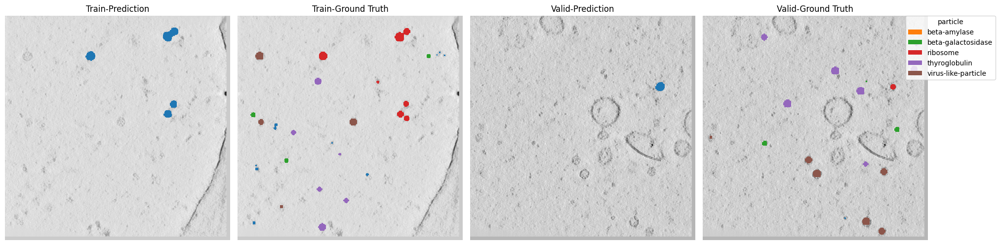

Train-Epoch: 43, Loss: 0.417794860402743: : 60it [00:07,  7.84it/s]                        
Train-nshuffle-Epoch: 43, Loss: 0.4163807661637016: 100%|██████████| 460/460 [00:06<00:00, 72.58it/s] 


EPOCH: 43, TRAIN_SCORE: 0.07525424270610431, TRAIN_SCORE_LIST: [0.0819277108433735, 0.06265356265356266, 0.10104011887072807, 0.05695523988206914, 0.0736945812807882]


Valid-Epoch: 43, Loss: 0.4468842019205508: 100%|██████████| 184/184 [00:02<00:00, 70.43it/s]  


EPOCH: 43, VALID_SCORE: 0.04101638339337009, VALID_SCORE_LIST: [0.04459813975673742, 0.037434627030002755]


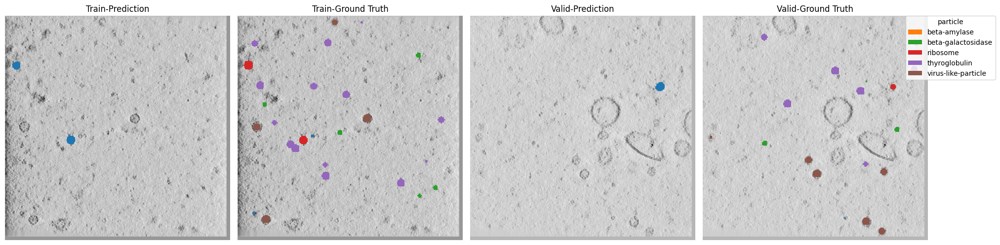

Train-Epoch: 44, Loss: 0.4118198921283086: : 60it [00:07,  7.80it/s]                       
Train-nshuffle-Epoch: 44, Loss: 0.4162567646607109: 100%|██████████| 460/460 [00:06<00:00, 73.41it/s]  


EPOCH: 44, TRAIN_SCORE: 0.08348180288842397, TRAIN_SCORE_LIST: [0.09686609686609686, 0.06657963446475196, 0.10491428571428571, 0.06341530809615915, 0.08563368930082611]


Valid-Epoch: 44, Loss: 0.4444091368628585: 100%|██████████| 184/184 [00:02<00:00, 65.52it/s]  


EPOCH: 44, VALID_SCORE: 0.05011252715503402, VALID_SCORE_LIST: [0.0471151423532376, 0.05310991195683044]


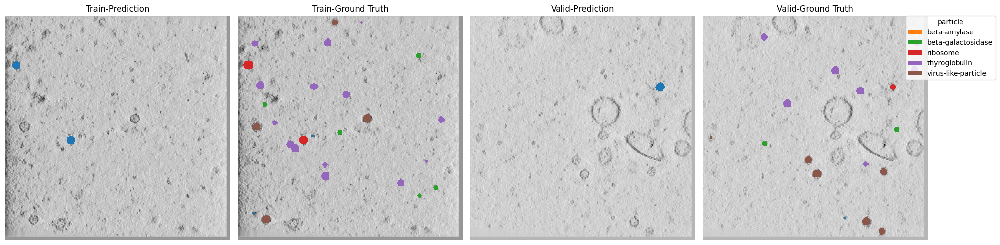

Train-Epoch: 45, Loss: 0.41713034013907113: : 60it [00:07,  7.76it/s]                      
Train-nshuffle-Epoch: 45, Loss: 0.41802232187727223: 100%|██████████| 460/460 [00:06<00:00, 70.92it/s]


EPOCH: 45, TRAIN_SCORE: 0.10180297280699727, TRAIN_SCORE_LIST: [0.11564625850340138, 0.0849645980841316, 0.12056737588652484, 0.08483033932135729, 0.10300629223957121]


Valid-Epoch: 45, Loss: 0.4437266604407974: 100%|██████████| 184/184 [00:02<00:00, 66.26it/s]  


EPOCH: 45, VALID_SCORE: 0.06617816908075358, VALID_SCORE_LIST: [0.06759443339960239, 0.06476190476190477]


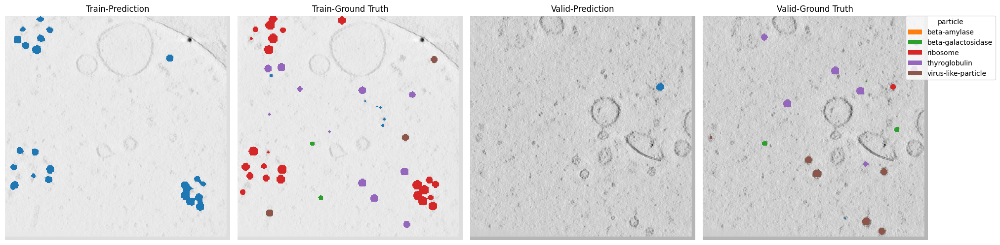

Train-Epoch: 46, Loss: 0.4128518283367157: : 60it [00:07,  7.78it/s]                       
Train-nshuffle-Epoch: 46, Loss: 0.4158915160790734: 100%|██████████| 460/460 [00:07<00:00, 64.02it/s] 


EPOCH: 46, TRAIN_SCORE: 0.07787535421164903, TRAIN_SCORE_LIST: [0.09264305177111716, 0.05741303613644039, 0.1035007610350076, 0.06341530809615915, 0.07240461401952085]


Valid-Epoch: 46, Loss: 0.4445628572417342: 100%|██████████| 184/184 [00:02<00:00, 74.01it/s]  


EPOCH: 46, VALID_SCORE: 0.040436244990030415, VALID_SCORE_LIST: [0.04343786295005808, 0.037434627030002755]


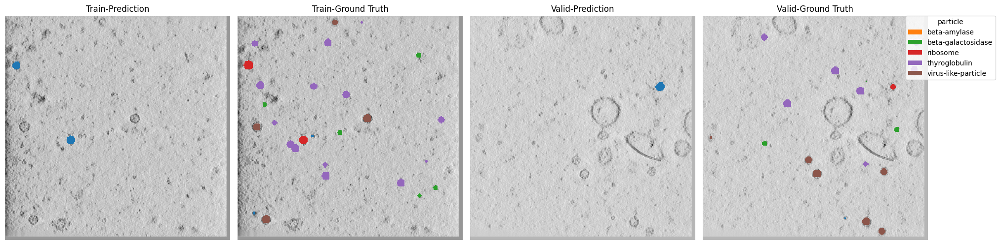

Train-Epoch: 47, Loss: 0.41375096638997394: : 60it [00:07,  7.89it/s]                      
Train-nshuffle-Epoch: 47, Loss: 0.4181227330280387: 100%|██████████| 460/460 [00:05<00:00, 78.97it/s]  


EPOCH: 47, TRAIN_SCORE: 0.1046608609361737, TRAIN_SCORE_LIST: [0.12396420285051375, 0.08302808302808302, 0.1237488626023658, 0.08955686396033466, 0.10300629223957121]


Valid-Epoch: 47, Loss: 0.444741889834404: 100%|██████████| 184/184 [00:02<00:00, 75.06it/s]   


EPOCH: 47, VALID_SCORE: 0.06594761885951794, VALID_SCORE_LIST: [0.06551059730250483, 0.06638464041653107]


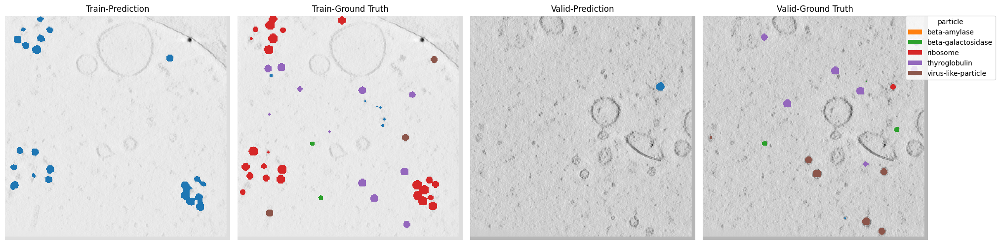

Train-Epoch: 48, Loss: 0.4190197139978409: : 60it [00:07,  8.05it/s]                       
Train-nshuffle-Epoch: 48, Loss: 0.4177301383536795: 100%|██████████| 460/460 [00:05<00:00, 81.97it/s]  


EPOCH: 48, TRAIN_SCORE: 0.10190223496457133, TRAIN_SCORE_LIST: [0.11564625850340138, 0.0849645980841316, 0.12126015454725579, 0.0872540633019675, 0.1003861003861004]


Valid-Epoch: 48, Loss: 0.44543216021164606: 100%|██████████| 184/184 [00:02<00:00, 72.95it/s] 


EPOCH: 48, VALID_SCORE: 0.06269832821894644, VALID_SCORE_LIST: [0.05901201602136182, 0.06638464041653107]


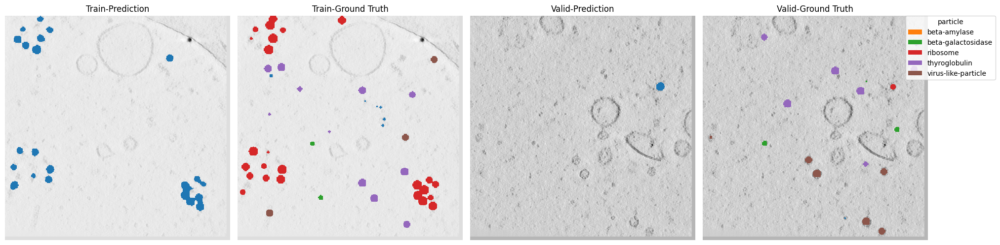

Train-Epoch: 49, Loss: 0.4208907594283422: : 60it [00:07,  7.96it/s]                       
Train-nshuffle-Epoch: 49, Loss: 0.41581260458282804: 100%|██████████| 460/460 [00:05<00:00, 79.33it/s] 


EPOCH: 49, TRAIN_SCORE: 0.07400028480293638, TRAIN_SCORE_LIST: [0.0887728459530026, 0.04983029929034249, 0.09980430528375732, 0.06731647883033809, 0.0642774946572415]


Valid-Epoch: 49, Loss: 0.4507609988036363: 100%|██████████| 184/184 [00:02<00:00, 71.40it/s]  


EPOCH: 49, VALID_SCORE: 0.029932305023025164, VALID_SCORE_LIST: [0.035954624110747936, 0.02390998593530239]


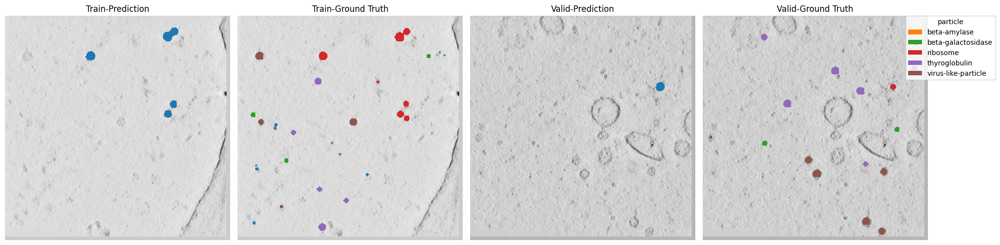

In [8]:
best_model = None
best_score = 0

for epoch in range(CFG.epochs):
    train_loss = []
    train_nshuffle_loss = []
    valid_loss = []

    # train_original_tomogram = defaultdict(list)
    ##train_pred_tomogram = defaultdict(list)
    # train_gt_tomogram = defaultdict(list)

    train_nshuffle_original_tomogram = defaultdict(list)
    train_nshuffle_pred_tomogram = defaultdict(list)
    train_nshuffle_gt_tomogram = defaultdict(list)

    valid_original_tomogram = defaultdict(list)
    valid_pred_tomogram = defaultdict(list)
    valid_gt_tomogram = defaultdict(list)

    model.train()
    tq = tqdm(range(len(train_loader) * normalized_tomogram.shape[0] // batch_size))
    for data in train_loader:
        exp_name = data["exp_name"][0]
        tomogram = data["normalized_tomogram"]
        segmentation_map = data["segmentation_map"]

        tomogram = tomogram.reshape(1, -1, tomogram.shape[-2], tomogram.shape[-1])
        segmentation_map = segmentation_map.reshape(
            1, -1, segmentation_map.shape[-2], segmentation_map.shape[-1]
        )

        random_index = torch.randperm(tomogram.shape[1])

        for i in range(0, tomogram.shape[1], batch_size):
            optimizer.zero_grad()
            input_ = (
                tomogram[:, random_index[i : i + batch_size]].to("cuda").transpose(0, 1)
            )
            gt = (
                segmentation_map[:, random_index[i : i + batch_size]]
                .to("cuda")
                .long()
                .squeeze()
            )
            # print(input_.shape, gt.shape)

            input_ = padf(input_)
            gt = padf(gt)
            # input_, gt = aug(input_, gt)
            output = model(input_)
            loss = seg_loss(output, gt)
            loss.backward()
            optimizer.step()
            scheduler.step()

            train_loss.append(loss.item())
            tq.set_description(f"Train-Epoch: {epoch}, Loss: {np.mean(train_loss)}")
            tq.update(1)

            # print(output.shape, gt.shape) # torch.Size([1, 7, 160, 160]) torch.Size([1, 160, 160])
            # train_pred_tomogram[exp_name].append(output.cpu().detach().numpy())
            # train_gt_tomogram[exp_name].append(gt.cpu().detach().numpy())
    tq.close()
    train_exp_name = exp_name

    ######################################## train-nshuffle #########################################
    model.eval()
    tq = tqdm(range(len(train_nshuffle_loader) * normalized_tomogram.shape[0]))
    for data in train_nshuffle_loader:
        exp_name = data["exp_name"][0]
        tomogram = data["normalized_tomogram"].to("cuda")
        segmentation_map = data["segmentation_map"].to("cuda").long()

        train_nshuffle_original_tomogram[exp_name] = (
            padf(tomogram).squeeze().cpu().detach().numpy()
        )

        for i in range(tomogram.shape[1]):
            input_ = tomogram[:, i].unsqueeze(0)
            gt = segmentation_map[:, i]

            input_ = padf(input_)
            gt = padf(gt)
            output = model(input_)
            loss = seg_loss(output, gt)

            train_nshuffle_loss.append(loss.item())
            tq.set_description(
                f"Train-nshuffle-Epoch: {epoch}, Loss: {np.mean(train_nshuffle_loss)}"
            )
            tq.update(1)

            # print(output.shape, gt.shape) # torch.Size([1, 7, 160, 160]) torch.Size([1, 160, 160])
            train_nshuffle_pred_tomogram[exp_name].append(output.cpu().detach().numpy())
            train_nshuffle_gt_tomogram[exp_name].append(gt.cpu().detach().numpy())
    tq.close()

    train_score_, train_score_list = visualize_epoch_results(
        train_nshuffle_pred_tomogram,
        base_dir="../../inputs/train/overlay/ExperimentRuns/",
        sikii_dict=CFG.initial_sikii,
    )
    print(
        f"EPOCH: {epoch}, TRAIN_SCORE: {train_score_}, TRAIN_SCORE_LIST: {train_score_list}"
    )

    ############################################# valid #############################################

    model.eval()
    tq = tqdm(range(len(valid_loader) * normalized_tomogram.shape[0]))
    for data in valid_loader:
        exp_name = data["exp_name"][0]
        tomogram = data["normalized_tomogram"].to("cuda")
        segmentation_map = data["segmentation_map"].to("cuda").long()

        valid_original_tomogram[exp_name] = (
            padf(tomogram).squeeze().cpu().detach().numpy()
        )

        for i in range(tomogram.shape[1]):
            input_ = tomogram[:, i].unsqueeze(0)
            gt = segmentation_map[:, i]

            input_ = padf(input_)
            gt = padf(gt)
            output = model(input_)
            loss = seg_loss(output, gt)

            valid_loss.append(loss.item())
            tq.set_description(f"Valid-Epoch: {epoch}, Loss: {np.mean(valid_loss)}")
            tq.update(1)

            # print(output.shape, gt.shape) # torch.Size([1, 7, 160, 160]) torch.Size([1, 160, 160])
            valid_pred_tomogram[exp_name].append(output.cpu().detach().numpy())
            valid_gt_tomogram[exp_name].append(gt.cpu().detach().numpy())
    tq.close()
    valid_exp_name = exp_name

    valid_score_, valid_score_list = visualize_epoch_results(
        valid_pred_tomogram,
        base_dir="../../inputs/train/overlay/ExperimentRuns/",
        sikii_dict=CFG.initial_sikii,
    )

    print(
        f"EPOCH: {epoch}, VALID_SCORE: {valid_score_}, VALID_SCORE_LIST: {valid_score_list}"
    )
    if valid_score_ > best_score:
        best_score = valid_score_
        best_model = model
        torch.save(model.state_dict(), f"best_model.pth")

    # 描画
    index = 30
    plt.figure(figsize=(20, 5))

    # Train-Pred-Plot
    ax = plt.subplot(1, 4, 1)
    pred = train_nshuffle_pred_tomogram[train_exp_name][index][0].argmax(0)
    plot_with_colormap(
        pred,
        "Train-Prediction",
        train_nshuffle_original_tomogram[train_exp_name][index],
    )

    # Train-GT-Plot
    ax = plt.subplot(1, 4, 2)
    gt = train_nshuffle_gt_tomogram[train_exp_name][index][0]
    plot_with_colormap(
        gt,
        "Train-Ground Truth",
        train_nshuffle_original_tomogram[train_exp_name][index],
    )

    # Valid-Pred-Plot
    ax = plt.subplot(1, 4, 3)
    pred = valid_pred_tomogram[valid_exp_name][index][0].argmax(0)
    plot_with_colormap(
        pred, "Valid-Prediction", valid_original_tomogram[valid_exp_name][index]
    )

    # Valid-GT-Plot
    ax = plt.subplot(1, 4, 4)
    gt = valid_gt_tomogram[valid_exp_name][index][0]
    plot_with_colormap(
        gt, "Valid-Ground Truth", valid_original_tomogram[valid_exp_name][index]
    )

    # 凡例を追加
    legend_elements = [
        Patch(facecolor=colors[i], label=CFG.particles_name[i])
        for i in range(1, num_classes)
    ]
    plt.legend(
        handles=legend_elements,
        loc="upper right",
        title="particle",
        bbox_to_anchor=(1.3, 1),  # 凡例を右上に配置
        borderaxespad=0,
    )

    plt.tight_layout()
    plt.show()

    # torch.save(model.state_dict(), "pretrained_model.pth")